<a href="https://colab.research.google.com/github/soumick1/Tensorflow_Sentiment_Analysis/blob/main/TF_Sentiment_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!nvidia-smi

Tue May 11 13:23:27 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 465.19.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   36C    P0    27W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
from __future__ import absolute_import, division, print_function, unicode_literals

try:
  !pip uninstall tb-nightly tensorboardX tensorboard
  !pip install tf-nightly
except Exception:
  pass
import tensorflow as tf

import os
import datetime
import tensorflow_datasets as tfds

%load_ext tensorboard

Uninstalling tb-nightly-2.6.0a20210510:
  Would remove:
    /usr/local/bin/tensorboard
    /usr/local/lib/python3.7/dist-packages/tb_nightly-2.6.0a20210510.dist-info/*
    /usr/local/lib/python3.7/dist-packages/tensorboard/*
  Would not remove (might be manually added):
    /usr/local/lib/python3.7/dist-packages/tensorboard/util/argparse_util.py
Proceed (y/n)? y
  Successfully uninstalled tb-nightly-2.6.0a20210510
Uninstalling tensorboardX-2.2:
  Would remove:
    /usr/local/lib/python3.7/dist-packages/tensorboardX-2.2.dist-info/*
    /usr/local/lib/python3.7/dist-packages/tensorboardX/*
Proceed (y/n)? y
  Successfully uninstalled tensorboardX-2.2
Uninstalling tensorboard-2.4.1:
  Would remove:
    /usr/local/lib/python3.7/dist-packages/tensorboard-2.4.1.dist-info/*
    /usr/local/lib/python3.7/dist-packages/tensorboard/util/argparse_util.py
Proceed (y/n)? y
  Successfully uninstalled tensorboard-2.4.1
     |████████████████████████████████| 453.3MB 25kB/s 
     |██████████████████████

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
import pkg_resources

for entry_point in pkg_resources.iter_entry_points('tensorboard_plugins'):
    print(entry_point.dist)

tensorboard 2.4.1
tensorboard-plugin-wit 1.8.0


In [ ]:
!rm -r /usr/local/lib/python3.7/dist-packages/tensorboardcolab-0.0.22.dist-info

rm: cannot remove '/usr/local/lib/python3.7/dist-packages/tensorboardcolab-0.0.22.dist-info': No such file or directory


In [ ]:
print(tf.__version__)

2.4.1


In [ ]:
dataset, info = tfds.load('amazon_us_reviews/Mobile_Electronics_v1_00', with_info=True)
train_dataset = dataset['train']

Shuffling and writing examples to /root/tensorflow_datasets/amazon_us_reviews/Mobile_Electronics_v1_00/0.1.0.incompletePPFZJE/amazon_us_reviews-train.tfrecord


Dataset amazon_us_reviews downloaded and prepared to /root/tensorflow_datasets/amazon_us_reviews/Mobile_Electronics_v1_00/0.1.0. Subsequent calls will reuse this data.


In [ ]:
info

tfds.core.DatasetInfo(
    name='amazon_us_reviews',
    version=0.1.0,
    description='Amazon Customer Reviews (a.k.a. Product Reviews) is one of Amazons iconic products. In a period of over two decades since the first review in 1995, millions of Amazon customers have contributed over a hundred million reviews to express opinions and describe their experiences regarding products on the Amazon.com website. This makes Amazon Customer Reviews a rich source of information for academic researchers in the fields of Natural Language Processing (NLP), Information Retrieval (IR), and Machine Learning (ML), amongst others. Accordingly, we are releasing this data to further research in multiple disciplines related to understanding customer product experiences. Specifically, this dataset was constructed to represent a sample of customer evaluations and opinions, variation in the perception of a product across geographical regions, and promotional intent or bias in reviews.

Over 130+ million cus

In [ ]:
len(list(train_dataset))

104975

In [ ]:
BUFFER_SIZE = 30000
BATCH_SIZE = 256

In [ ]:
train_dataset = train_dataset.shuffle(BUFFER_SIZE, reshuffle_each_iteration=False)

In [ ]:
for review in train_dataset.take(2):
  print(review)

{'data': {'customer_id': <tf.Tensor: shape=(), dtype=string, numpy=b'20273425'>, 'helpful_votes': <tf.Tensor: shape=(), dtype=int32, numpy=20>, 'marketplace': <tf.Tensor: shape=(), dtype=string, numpy=b'US'>, 'product_category': <tf.Tensor: shape=(), dtype=string, numpy=b'Mobile_Electronics'>, 'product_id': <tf.Tensor: shape=(), dtype=string, numpy=b'B004RD1KMS'>, 'product_parent': <tf.Tensor: shape=(), dtype=string, numpy=b'755810717'>, 'product_title': <tf.Tensor: shape=(), dtype=string, numpy=b'Mini Bluetooth HID Wireless Keyboard for Motorola Xoom'>, 'review_body': <tf.Tensor: shape=(), dtype=string, numpy=b"Allows me to use my Xoom with a full qwerty keyboard, and a mouse pointer thumbstick. It's great. It allows me to actually type on my Xoom with a full screen, and with full mouse controls (pointer, two buttons, and a a scroll touch pad). It's the best thing I've bought since my Xoom. It makes Internet browsing that much easier on this sensitive touch screen device; my fingers a

In [ ]:
for reviews in train_dataset.take(10):
  review_text = reviews['data']
  print(review_text.get('review_body').numpy())
  print(review_text.get('star_rating'))
  print(tf.where(review_text.get('star_rating')>3,1,0).numpy())

b"Allows me to use my Xoom with a full qwerty keyboard, and a mouse pointer thumbstick. It's great. It allows me to actually type on my Xoom with a full screen, and with full mouse controls (pointer, two buttons, and a a scroll touch pad). It's the best thing I've bought since my Xoom. It makes Internet browsing that much easier on this sensitive touch screen device; my fingers are pretty big and my hands shake sometimes, so hitting the right link can be difficult on a bad day. This helps tremendously.<br />Bluetooth connectivity was a breeze, no problems there. After switching it on, the device was recognized within a few seconds, and pairing was as easy as the instruction book made it out to be.<br />Not sure about max range, but I do have a Windows PC hooked to my HDTV as a media vault, and it works great from across the room as well (maybe 10 feet)."
tf.Tensor(5, shape=(), dtype=int32)
1
b"The power on this is great. But it is really a pain that you have to have a cord with two USB

In [ ]:
tokenizer = tfds.deprecated.text.Tokenizer()

In [ ]:
vocabulary_set = set()
for _, reviews in train_dataset.enumerate():
  #print(reviews)
  review_text = reviews['data']
  reviews_tokens = tokenizer.tokenize(review_text.get('review_body').numpy())
  vocabulary_set.update(reviews_tokens)

vocab_size = len(vocabulary_set)
vocab_size

73738

In [ ]:
encoder = tfds.deprecated.text.TokenTextEncoder(vocabulary_set)

In [ ]:
print(vocabulary_set)

{'Basic', '1895', 'Impedance', 'Musk', 'bac', 'jodybrianjohnson', 'freakin', 'Callee', 'kiddies', 'thoughts', 'sac', 'B001FA1O18', 'plate', 'thouching', 'remainder', 'DR400G', 'carabeener', 'disappionted', 'Tafseer', 'Rayburn', 'Tape', 'particially', 'Pitiful', 'maunal', 'B00CLGZZR4', 'TESTED', 'Syncs', 'Repeated', 'Grizzly', 'wrangler', 'ChrisRay', 'easel', 'blink', 'mAh', 'mosfet', 'sugestion', 'livened', 'Debian', 'AP', '5045LM', 'jumbling', 'HERS', 'interstation', 'leatherette', 'WONT', 'hoot', 'runs', 'anbd', 'measures', 'botched', 'boyfriends', 'dispatcher', 'Thie', 'rattail', 'appreciating', 'Dosnt', 'funded', 'EZO', 'SX50', 'Soundfly', '2XAA', 'clinched', 'MFi', 'fiberglassed', 'iCruiser', 'Onyx', 'organs', 'DACS', 'Robyn', 'foolproof', 'censors', 'acquaintencies', 'Antonio', 'CTCSS', 'JUSTIN', 'subwoolfer', 'angst', 'sportbike', 'former', 'graingers', 'neglected', 'exactally', 'cancelling', '3200', 'corrosive', 'braided', 'rales', 'Synching', 'FOG', 'Tunnel', 'CRUSSING', 'gidd

In [ ]:
for reviews in train_dataset.take(5):
  review_text = reviews['data']
  print(review_text.get('review_body').numpy())
  encoded_example = encoder.encode(review_text.get('review_body').numpy())
  print(encoded_example)

b"Allows me to use my Xoom with a full qwerty keyboard, and a mouse pointer thumbstick. It's great. It allows me to actually type on my Xoom with a full screen, and with full mouse controls (pointer, two buttons, and a a scroll touch pad). It's the best thing I've bought since my Xoom. It makes Internet browsing that much easier on this sensitive touch screen device; my fingers are pretty big and my hands shake sometimes, so hitting the right link can be difficult on a bad day. This helps tremendously.<br />Bluetooth connectivity was a breeze, no problems there. After switching it on, the device was recognized within a few seconds, and pairing was as easy as the instruction book made it out to be.<br />Not sure about max range, but I do have a Windows PC hooked to my HDTV as a media vault, and it works great from across the room as well (maybe 10 feet)."
[65611, 19465, 70239, 64729, 40612, 8178, 52187, 32621, 61624, 31898, 65844, 60874, 32621, 24224, 22048, 65831, 69493, 41340, 430, 69

In [ ]:
def encode(text_tensor, label_tensor):
  encoded_text = encoder.encode(text_tensor.numpy())
  label = tf.where(label_tensor>3,1,0)
  return encoded_text, label

In [ ]:
def encode_map_fn(tensor):

  text = tensor['data'].get('review_body')
  label = tensor['data'].get('star_rating')

  encoded_text, label = tf.py_function(encode, inp=[text, label], Tout=(tf.int64, tf.int32))

  encoded_text.set_shape([None])
  label.set_shape([])

  return encoded_text, label

In [ ]:
ar_encoded_data = train_dataset.map(encode_map_fn)

In [ ]:
for f0,f1 in ar_encoded_data.take(2):
  print(f0)
  print(f1)

tf.Tensor(
[65611 19465 70239 64729 40612  8178 52187 32621 61624 31898 65844 60874
 32621 24224 22048 65831 69493 41340   430 69493 51490 19465 70239   470
  4586 48045 40612  8178 52187 32621 61624 50230 60874 52187 61624 24224
  1614 22048 47349  9444 60874 32621 32621 15744 64229 65286 69493 41340
 68050  4799 41202 68157 64916 38019 29407 40612  8178 69493 28298  7657
 19512 44682 23354 17319 48045  4643 53359 64229 50230 20892 40612 43767
 53044 19126 32120 60874 40612 62886 67941 49274 13392 20764 68050  9013
 61343 50546 63557 45780 48045 32621 17521 70902 33805 39126  4840 28627
 39963 30640 54932 32621 70228 33210 16285 32308 35140 35498 23621 48045
 68050 20892 54932 31529 45419 32621 21754 13904 60874 59903 54932 32811
 38854 32811 68050 28571 67629 28933 23621 14175 70239 63557 28627 19515
 10543 67408 64895 67596 52639 68157 56980 40119 32621 38134 15259 45480
 70239 40612 45591 32811 32621 66433 44383 60874 23621 12680   430 71647
 61358 68050  4651 32811  9563 43902  46

In [ ]:
TAKE_SIZE = 10000

train_data = ar_encoded_data.skip(TAKE_SIZE).shuffle(BUFFER_SIZE)
train_data = train_data.padded_batch(BATCH_SIZE)

test_data = ar_encoded_data.take(TAKE_SIZE)
test_data = test_data.padded_batch(BATCH_SIZE)

In [ ]:
vocab_size +=1

In [ ]:
sample_text, sample_labels = next(iter(test_data))

sample_text[0], sample_labels[0]

(<tf.Tensor: shape=(757,), dtype=int64, numpy=
 array([65611, 19465, 70239, 64729, 40612,  8178, 52187, 32621, 61624,
        31898, 65844, 60874, 32621, 24224, 22048, 65831, 69493, 41340,
          430, 69493, 51490, 19465, 70239,   470,  4586, 48045, 40612,
         8178, 52187, 32621, 61624, 50230, 60874, 52187, 61624, 24224,
         1614, 22048, 47349,  9444, 60874, 32621, 32621, 15744, 64229,
        65286, 69493, 41340, 68050,  4799, 41202, 68157, 64916, 38019,
        29407, 40612,  8178, 69493, 28298,  7657, 19512, 44682, 23354,
        17319, 48045,  4643, 53359, 64229, 50230, 20892, 40612, 43767,
        53044, 19126, 32120, 60874, 40612, 62886, 67941, 49274, 13392,
        20764, 68050,  9013, 61343, 50546, 63557, 45780, 48045, 32621,
        17521, 70902, 33805, 39126,  4840, 28627, 39963, 30640, 54932,
        32621, 70228, 33210, 16285, 32308, 35140, 35498, 23621, 48045,
        68050, 20892, 54932, 31529, 45419, 32621, 21754, 13904, 60874,
        59903, 54932, 32811, 3

In [ ]:
for f0,f1 in test_data.take(10):
  print(tf.unique_with_counts(f1)[2].numpy())

[176  80]
[ 89 167]
[ 84 172]
[ 91 165]
[176  80]
[174  82]
[177  79]
[168  88]
[167  89]
[169  87]


In [ ]:
model = tf.keras.Sequential()
model.add(tf.keras.layers.Embedding(vocab_size, 128))
model.add(tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(128, return_sequences=True)))
#model.add(tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(64, return_sequences=True)))
model.add(tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(64)))
for units in [64,32,16]:
  model.add(tf.keras.layers.Dense(units, activation='relu'))
  model.add(tf.keras.layers.Dropout(units*0.006))
model.add(tf.keras.layers.Dense(1))

In [ ]:
!rm -r /tmp/logs/

rm: cannot remove '/tmp/logs/': No such file or directory


In [ ]:
logdir = os.path.join('/tmp/logs', datetime.datetime.now().strftime('%Y%m%d-%H%M%S'))
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)
checkpointer = tf.keras.callbacks.ModelCheckpoint(filepath = '/tmp/sentiment_analysis.hdf5', verbose = 1, save_best_only=True)

model.compile(optimizer='adam',
              loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [ ]:
history=model.fit(train_data, epochs=6, validation_data=test_data, callbacks=[tensorboard_callback,checkpointer])

Epoch 1/6
371/371 [==============================] - 266s 581ms/step - loss: 0.4790 - accuracy: 0.7306 - val_loss: 0.3248 - val_accuracy: 0.8747

Epoch 00001: val_loss improved from inf to 0.32483, saving model to /tmp/sentiment_analysis.hdf5
Epoch 2/6
371/371 [==============================] - 250s 585ms/step - loss: 0.2710 - accuracy: 0.8913 - val_loss: 0.3125 - val_accuracy: 0.8641

Epoch 00002: val_loss improved from 0.32483 to 0.31249, saving model to /tmp/sentiment_analysis.hdf5
Epoch 3/6
371/371 [==============================] - 249s 582ms/step - loss: 0.2310 - accuracy: 0.9094 - val_loss: 0.2863 - val_accuracy: 0.8818

Epoch 00003: val_loss improved from 0.31249 to 0.28632, saving model to /tmp/sentiment_analysis.hdf5
Epoch 4/6
371/371 [==============================] - 249s 583ms/step - loss: 0.1733 - accuracy: 0.9335 - val_loss: 0.2996 - val_accuracy: 0.8772

Epoch 00004: val_loss did not improve from 0.28632
Epoch 5/6
371/371 [==============================] - 247s 579ms/st

In [ ]:
model.save('/tmp/final_sentiment_analysis.hdf5')

In [ ]:
!ls -alrt /tmp/*.hdf5

-rw-r--r-- 1 root root 118623592 May 11 13:40 /tmp/sentiment_analysis.hdf5
-rw-r--r-- 1 root root 118623592 May 11 13:52 /tmp/final_sentiment_analysis.hdf5


In [ ]:
eval_loss, eval_acc = model.evaluate(test_data)

print('\nEval loss: {:.3f}, Eval accuracy: {:.3f}'.format(eval_loss, eval_acc))

40/40 [==============================] - 15s 345ms/step - loss: 0.3540 - accuracy: 0.8748

Eval loss: 0.354, Eval accuracy: 0.875


In [ ]:
model.layers

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, None, 128)         9438592   
_________________________________________________________________
bidirectional (Bidirectional (None, None, 256)         263168    
_________________________________________________________________
bidirectional_1 (Bidirection (None, 128)               164352    
_________________________________________________________________
dense (Dense)                (None, 64)                8256      
_________________________________________________________________
dropout (Dropout)            (None, 64)                0         
_________________________________________________________________
dense_1 (Dense)              (None, 32)                2080      
_________________________________________________________________
dropout_1 (Dropout)          (None, 32)                0

In [ ]:
model.get_layer('embedding').output

<KerasTensor: shape=(None, None, 128) dtype=float32 (created by layer 'embedding')>

In [ ]:
!nvidia-smi

Tue May 11 14:02:26 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 465.19.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   38C    P0    35W / 250W |  15565MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
import matplotlib.pyplot as plt

def plot_graphs(history, metric):
  plt.plot(history.history[metric])
  plt.plot(history.history['val_'+metric], '')
  plt.xlabel("Epochs")
  plt.ylabel(metric)
  plt.legend([metric, 'val_'+metric])
  plt.show()

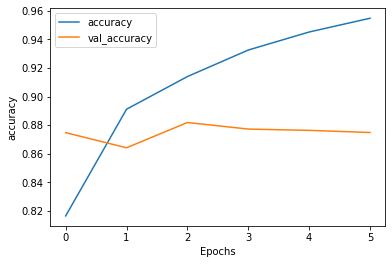

In [ ]:
plot_graphs(history, 'accuracy')

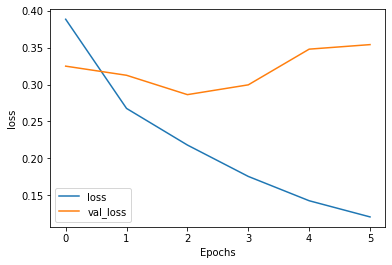

In [ ]:
plot_graphs(history, 'loss')

In [ ]:
tf.keras.backend.clear_session()
sa_load = tf.keras.models.load_model('/tmp/sentiment_analysis.hdf5',compile = False)
#sa_load = tf.keras.models.load_model('/tmp/final_sentiment_analysis.hdf5',compile = False)

In [ ]:
def pad_to_size(vec, size):
  zeros = [0] * (size - len(vec))
  vec.extend(zeros)
  return vec

In [ ]:
def predict_fn(pred_text):
  encoded_pred_text = encoder.encode(pred_text)
  print(encoded_pred_text)
  encoded_pred_text = pad_to_size(encoded_pred_text, 32)
  print(encoded_pred_text)
  encoded_pred_text = tf.cast(encoded_pred_text, tf.float32)
  predictions = sa_load.predict(tf.expand_dims(encoded_pred_text, 0))

  return (predictions)

In [ ]:
pred_text = ('Quality is not up to the mark. Very bad service response.')
predictions = predict_fn(pred_text)
print(predictions)

[8234, 64125, 26657, 31310, 70239, 68050, 54153, 3261, 17521, 52027, 71150]
[8234, 64125, 26657, 31310, 70239, 68050, 54153, 3261, 17521, 52027, 71150, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[[-2.4301698]]


In [ ]:
pred_text = ('Amazing product. Fast Delivery. Nice packing')
predictions = predict_fn(pred_text)
print(predictions)

[17329, 50836, 65920, 24427, 49609, 27633]
[17329, 50836, 65920, 24427, 49609, 27633, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[[6.0267334]]


In [ ]:
pred_text = ('Nice product. Packing could have been better')
predictions = predict_fn(pred_text)
print(predictions)

[49609, 50836, 29864, 6645, 40119, 29070, 20002]
[49609, 50836, 29864, 6645, 40119, 29070, 20002, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[[3.2310848]]


In [ ]:
print(tf.distribute.get_strategy())

In [ ]:
%reload_ext tensorboard

In [ ]:
%tensorboard --logdir /tmp/logs

<IPython.core.display.Javascript object>

In [ ]:
from tensorboard import notebook
notebook.list()

Known TensorBoard instances:
  - port 6006: logdir /tmp/logs (started 0:02:19 ago; pid 1765)


In [ ]:
notebook.display(port=6006, height=1000)

Selecting TensorBoard with logdir /tmp/logs (started 0:02:32 ago; port 6006, pid 1765).


<IPython.core.display.Javascript object>